In [3]:
import numpy as np
import plotly.graph_objects as go
import polars as pl
import pyEDM
from edmkit.smap import smap
from sklearn.linear_model import LinearRegression

In [4]:
# ICA(N-2), ball(right/left, fwd)
df_fly = pl.read_csv("../data/Fly80XY_norm.csv")
df_fish = pl.read_csv("../data/Trace_Hypo_Fish1_135658.csv")
df_motion = pl.read_csv("../data/motions/jog_16/sub_1.csv").drop("")

In [5]:
fly_CC_cols = ["TS12", "TS44", "TS74", "TS33", "TS57", "TS78", "TS76"]
fly_best_cols = list(set(["TS32", "TS20", "TS57", "TS76", "TS57", "TS69", "TS9"]))

fish_best_cols = list(set(["51889", "52214", "51873", "52113", "42274", "51871", "52071", "52297", "5254", "39733"]))

motion_best_cols = df_motion.columns[1:]
i = 9
target_col = motion_best_cols[i]
motion_best_cols = motion_best_cols[:i] + motion_best_cols[i + 1 :]
print(target_col, motion_best_cols)

userAcceleration.y ['attitude.pitch', 'attitude.yaw', 'gravity.x', 'gravity.y', 'gravity.z', 'rotationRate.x', 'rotationRate.y', 'rotationRate.z', 'userAcceleration.x', 'userAcceleration.z']


In [8]:
df_fish["51873"]

51873
f64
0.16138
0.12293
0.17157
0.17716
0.24223
…
-0.009176
0.000025
0.0088983


In [9]:
layout = go.Layout(
    title="Fly80XY_norm",
)

data = [
    go.Scatter(
        x=list(range(len(df_fly))),
        y=df_fly[col],
        showlegend=False,
    )
    for col in df_fly.columns
]

fig = go.Figure(data=data, layout=layout)
fig.show()

In [10]:
# remove first 200 timepoints

layout = go.Layout(
    title="Trace_Hypo_Fish1_135658",
)

data = [
    go.Scatter(
        x=list(range(len(df_fish))),
        y=df_fish[col][200:],
        showlegend=False,
    )
    for col in df_fish.columns[:10]
]

fig = go.Figure(data=data, layout=layout)
fig.show()

In [11]:
layout = go.Layout(
    title="motions/jog_16/sub_1.csv",
)

data = [
    go.Scatter(
        name=col,
        x=list(range(len(df_motion))),
        y=df_motion[col],
    )
    for col in df_motion.columns
]

fig = go.Figure(data=data, layout=layout)
fig.show()

In [12]:
layout = go.Layout(
    title="Fly80XY_norm(best)",
)

data = [
    go.Scatter(
        x=list(range(len(df_fly))),
        y=df_fly[col],
        showlegend=False,
    )
    for col in fly_best_cols
]

fig = go.Figure(data=data, layout=layout)
fig.show()

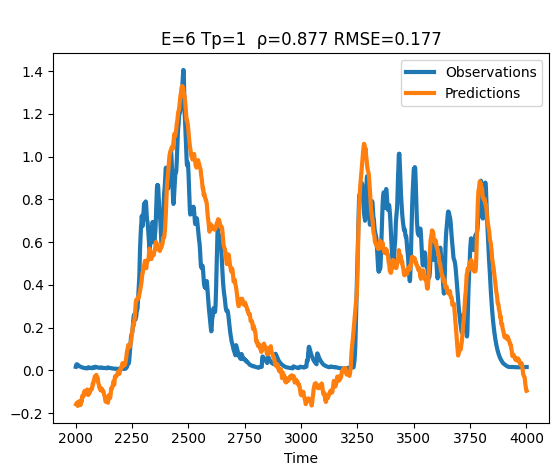

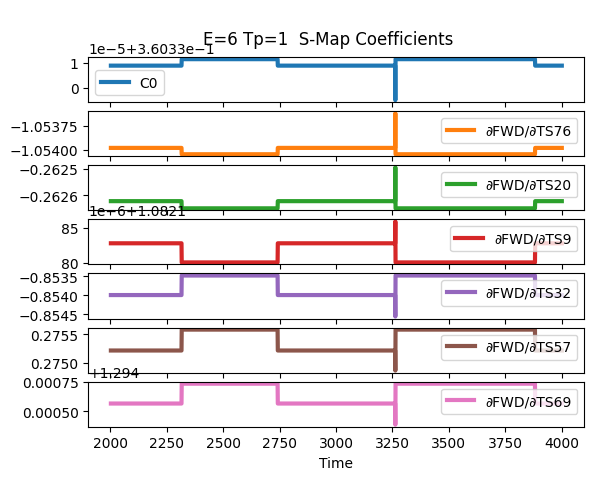

In [13]:
fly_result: dict = pyEDM.SMap(  # type: ignore
    dataFrame=df_fly.select(fly_best_cols + ["FWD"]).to_pandas(),
    columns=" ".join(fly_best_cols),
    target="FWD",
    lib="1 2000",
    pred="2001 4000",
    solver=LinearRegression(),
    embedded=True,
    showPlot=True,
    noTime=True,
)

In [9]:
from edmkit.util import autocorrelation

autocorr = autocorrelation(df_fly["FWD"].to_numpy(), 1000, step=10)

layout = go.Layout(
    title="Fly80XY_norm(best)",
)

data = [
    go.Scatter(
        x=np.arange(0, 1000, 10),
        y=autocorr,
        showlegend=False,
    )
]

fig = go.Figure(data=data, layout=layout)
fig.show()

In [ ]:
from edmkit.ccm import search_best_embedding

tau_list = np.arange(1, 100, 10).tolist()
e_list = np.arange(1, 10).tolist()

search_best_embedding(df_fly["FWD"].to_numpy(), tau_list, e_list, 300)

In [14]:
fly_result["coefficients"]

,Time,C0,∂FWD/∂TS76,∂FWD/∂TS20,∂FWD/∂TS9,∂FWD/∂TS32,∂FWD/∂TS57,∂FWD/∂TS69
0,2001,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2002,0.360339,-1.053982,-0.262623,1.082183,-0.853995,0.275217,1.294566
2,2003,0.360339,-1.053982,-0.262623,1.082183,-0.853995,0.275217,1.294566
3,2004,0.360339,-1.053982,-0.262623,1.082183,-0.853995,0.275217,1.294566
4,2005,0.360339,-1.053982,-0.262623,1.082183,-0.853995,0.275217,1.294566
...,...,...,...,...,...,...,...,...
1996,3997,0.360339,-1.053982,-0.262623,1.082183,-0.853995,0.275217,1.294566
1997,3998,0.360339,-1.053982,-0.262623,1.082183,-0.853995,0.275217,1.294566
1998,3999,0.360339,-1.053982,-0.262623,1.082183,-0.853995,0.275217,1.294566
1999,4000,0.360339,-1.053982,-0.262623,1.082183,-0.853995,0.275217,1.294566


In [15]:
fly_diffs = {
    col_name: abs((max(col[1:]) - min(col[1:])) / np.mean(col[1:]))
    for col_name, col in fly_result["coefficients"].items()
}
{col_name: diff for col_name, diff in sorted(fly_diffs.items(), key=lambda x: x[1], reverse=True)}

{'Time': np.float64(0.66600033316675),
 '∂FWD/∂TS57': np.float64(0.002609415976636488),
 '∂FWD/∂TS32': np.float64(0.001259482202940747),
 '∂FWD/∂TS20': np.float64(0.0005894061931717546),
 '∂FWD/∂TS76': np.float64(0.0004035714429689554),
 '∂FWD/∂TS69': np.float64(0.0002719217538969482),
 'C0': np.float64(4.551834403217786e-05),
 '∂FWD/∂TS9': np.float64(5.324963438779838e-06)}

In [16]:
# fly_cols = ["TS57", "TS32", "TS20"]
fly_cols = ["TS76", "TS69", "TS9"]

layout = go.Layout(
    title="Fly80XY_3D_embedding",
    width=800,
    height=800,
)

data = [
    go.Scatter3d(
        x=df_fly[fly_cols[0]],
        y=df_fly[fly_cols[1]],
        z=df_fly[fly_cols[2]],
        mode="markers+lines",
        marker=dict(
            size=2,
            color=df_fly["FWD"],
            colorscale="Viridis",
        ),
        line=dict(
            color=df_fly["FWD"],
            colorscale="Viridis",
        ),
    )
]

fig = go.Figure(data=data, layout=layout)
fig.show()

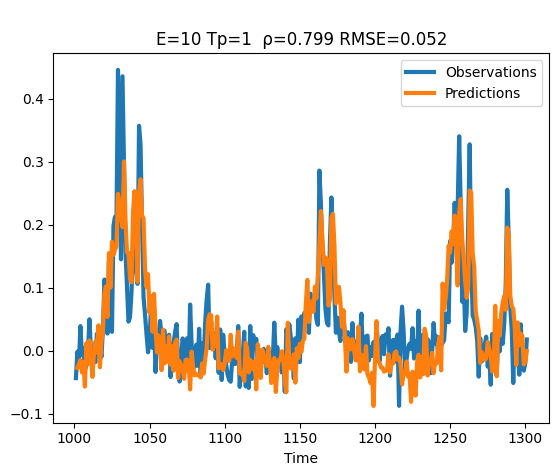

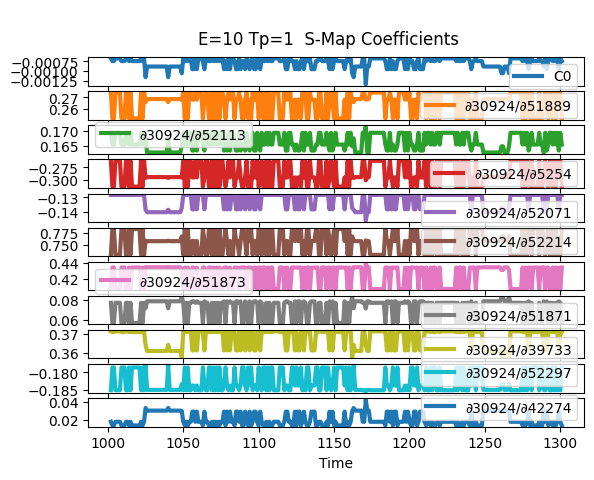

In [17]:
fish_result: dict = pyEDM.SMap(  # type: ignore
    dataFrame=df_fish.to_pandas(),
    columns=" ".join(fish_best_cols),
    target="30924",
    lib="301 850",
    pred="1001 1300",
    solver=LinearRegression(),
    embedded=True,
    showPlot=True,
    noTime=True,
)

In [18]:
fish_diffs = {
    col_name: abs((max(col[1:]) - min(col[1:])) / np.mean(col[1:]))
    for col_name, col in fish_result["coefficients"].items()
}
{col_name: diff for col_name, diff in sorted(fish_diffs.items(), key=lambda x: x[1], reverse=True)}

{'∂30924/∂42274': np.float64(1.3808860275706925),
 'C0': np.float64(0.8453062161346037),
 '∂30924/∂51871': np.float64(0.3599167245563699),
 'Time': np.float64(0.2596613113330439),
 '∂30924/∂5254': np.float64(0.18088575408142216),
 '∂30924/∂52071': np.float64(0.13866744290830663),
 '∂30924/∂51889': np.float64(0.08510648832141723),
 '∂30924/∂51873': np.float64(0.07653009133750205),
 '∂30924/∂52214': np.float64(0.07092862194301043),
 '∂30924/∂52113': np.float64(0.052004198417757004),
 '∂30924/∂52297': np.float64(0.040672086791051186),
 '∂30924/∂39733': np.float64(0.0358948708972816)}

In [19]:
fish_cols = ["42274", "51871", "5254"]

layout = go.Layout(
    title="Fish_3D_embedding",
    width=800,
    height=800,
)

data = [
    go.Scatter3d(
        x=df_fish[fish_cols[0]],
        y=df_fish[fish_cols[1]],
        z=df_fish[fish_cols[2]],
        mode="markers+lines",
        marker=dict(
            size=2,
            color=df_fish["30924"],
            colorscale="Viridis",
        ),
        line=dict(
            color=df_fish["30924"],
            colorscale="Viridis",
        ),
    )
]

fig = go.Figure(data=data, layout=layout)
fig.show()

In [20]:
len(df_motion)

1567

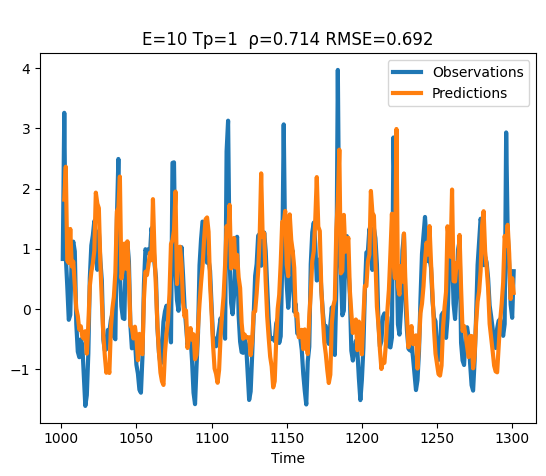

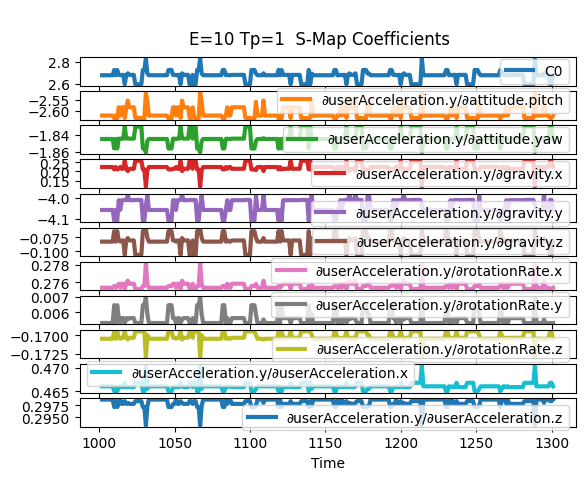

In [21]:
motion_result: dict = pyEDM.SMap(  # type: ignore
    dataFrame=df_motion.to_pandas(),
    columns=" ".join(motion_best_cols),
    target=target_col,
    lib="101 850",
    pred="1001 1300",
    solver=LinearRegression(),
    embedded=True,
    showPlot=True,
    noTime=True,
)

In [22]:
motion_diffs = {
    col_name: abs((max(col[1:]) - min(col[1:])) / np.mean(col[1:]))
    for col_name, col in motion_result["coefficients"].items()
}
{col_name: diff for col_name, diff in sorted(motion_diffs.items(), key=lambda x: x[1], reverse=True)}

{'∂userAcceleration.y/∂gravity.x': np.float64(0.6351456737300855),
 '∂userAcceleration.y/∂gravity.z': np.float64(0.5558971424118611),
 '∂userAcceleration.y/∂rotationRate.y': np.float64(0.3070040021830787),
 'Time': np.float64(0.2596613113330439),
 'C0': np.float64(0.0895448094266389),
 '∂userAcceleration.y/∂attitude.pitch': np.float64(0.04521188445359737),
 '∂userAcceleration.y/∂gravity.y': np.float64(0.029919861331128724),
 '∂userAcceleration.y/∂rotationRate.z': np.float64(0.020145581367407128),
 '∂userAcceleration.y/∂userAcceleration.z': np.float64(0.01807881768592915),
 '∂userAcceleration.y/∂attitude.yaw': np.float64(0.01671119175100882),
 '∂userAcceleration.y/∂userAcceleration.x': np.float64(0.011841774047436682),
 '∂userAcceleration.y/∂rotationRate.x': np.float64(0.0108031103913025)}

In [23]:
# motion_cols = ["gravity.x", "gravity.z", "rotationRate.y"]
motion_cols = ["gravity.x", "gravity.y", "gravity.z"]

layout = go.Layout(
    title="motions/jog_16/sub_1.csv 3D Embedding",
    width=800,
    height=800,
)

data = [
    go.Scatter3d(
        x=df_motion[motion_cols[0]],
        y=df_motion[motion_cols[1]],
        z=df_motion[motion_cols[2]],
        mode="markers+lines",
        marker=dict(
            size=2,
            color=df_motion[target_col],
            colorscale="Viridis",
        ),
        line=dict(
            color=df_motion[target_col],
            colorscale="Viridis",
        ),
        hovertemplate=f"{motion_cols[0]}: %{{x}}<br>{motion_cols[1]}: %{{y}}<br>{motion_cols[2]}: %{{z}}<br>{target_col}: %{{marker.color}}<extra></extra>",
    )
]

fig = go.Figure(data=data, layout=layout)
fig.show()

In [24]:
import torch


def smap(
    X: torch.Tensor,
    Y: torch.Tensor,
    t: torch.Tensor,
    theta: float,
    partition: int,
    exclusion_radius: int | None = None,
):
    assert X.shape[0] == Y.shape[0], "X and Y must have the same length"

    D = torch.cdist(X[t], X[:partition])
    D_mean = D.mean(dim=1, keepdim=True)

    W = torch.exp(-theta * D / D_mean)

    A = W.unsqueeze(-1) * X[:partition].unsqueeze(0)
    B = X[t].unsqueeze(-1)
    print(f"A: {A.shape}, B: {B.shape}")

    U, S, V = torch.svd(A)
    S = torch.diag_embed(S)
    print(f"U {U.shape} S {S.shape} V {V.shape}")

    S_inv = torch.where(S > 1e-5 * torch.max(S), 1.0 / S, torch.zeros_like(S))
    print(f"S_inv {S_inv.shape}")

    print(f"U.transpose(-2, -1) {U.transpose(-2, -1).shape} torch.bmm(V, S_inv) {torch.bmm(V, S_inv).shape}")
    A_pinv = torch.bmm(torch.bmm(V, S_inv), U.transpose(-2, -1))
    print(f"A_pinv {A_pinv.shape}")

    print(f"A_pinv.transpose(-2, -1) {A_pinv.transpose(-2, -1).shape} B {B.shape}")
    C = torch.bmm(A_pinv.transpose(-2, -1), B).squeeze(-1)
    print(f"C {C.shape}")

    observations = Y[t]
    print(f"W {W.shape} Y[:partition] {Y[:partition].shape} W @ Y[:partition] {(W @ Y[:partition]).shape}")
    predictions = torch.bmm(C.unsqueeze(1), (W.unsqueeze(-1) * Y[:partition].unsqueeze(0))).squeeze(1)
    print(f"observations {observations.shape} predictions {predictions.shape}")

    return observations, predictions, C


A module that was compiled using NumPy 1.x cannot be run in
NumPy 2.0.0 as it may crash. To support both 1.x and 2.x
versions of NumPy, modules must be compiled with NumPy 2.0.
Some module may need to rebuild instead e.g. with 'pybind11>=2.12'.

If you are a user of the module, the easiest solution will be to
downgrade to 'numpy<2' or try to upgrade the affected module.
We expect that some modules will need time to support NumPy 2.

Traceback (most recent call last):  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "/Users/temma/ghq/LabRotations/CHAOS/.venv/lib/python3.12/site-packages/ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "/Users/temma/ghq/LabRotations/CHAOS/.venv/lib/python3.12/site-packages/traitlets/config/application.py", line 1075, in launch_instance
    app.start()
  File "/Users/temma/ghq/LabRotations/CHAOS/.venv/lib/python3.12/site-packages/ipykernel/kernelapp.py", line 7

In [25]:
arr = df_fly.select(fly_best_cols).to_numpy()

X = torch.tensor(arr[:-10])
Y = torch.tensor(arr[10:])
t = torch.arange(len(arr) // 2, len(arr) // 2 + 2000)

print(f"X {X.shape}, Y {Y.shape}, t {t.shape}")

observations, predictions, coefficien = smap(X, Y, t, 1, len(arr) // 2 - 1)

X torch.Size([10598, 6]), Y torch.Size([10598, 6]), t torch.Size([2000])
A: torch.Size([2000, 5303, 6]), B: torch.Size([2000, 6, 1])
U torch.Size([2000, 5303, 6]) S torch.Size([2000, 6, 6]) V torch.Size([2000, 6, 6])
S_inv torch.Size([2000, 6, 6])
U.transpose(-2, -1) torch.Size([2000, 6, 5303]) torch.bmm(V, S_inv) torch.Size([2000, 6, 6])
A_pinv torch.Size([2000, 6, 5303])
A_pinv.transpose(-2, -1) torch.Size([2000, 5303, 6]) B torch.Size([2000, 6, 1])
C torch.Size([2000, 5303])
W torch.Size([2000, 5303]) Y[:partition] torch.Size([5303, 6]) W @ Y[:partition] torch.Size([2000, 6])
observations torch.Size([2000, 6]) predictions torch.Size([2000, 6])


In [26]:
layout = go.Layout(
    title="Fly80XY_norm(best)",
)

data = [
    go.Scatter(
        name="observations",
        x=list(range(len(observations))),
        y=np.array(observations[:-10, 1].tolist()),
        showlegend=False,
    ),
    go.Scatter(
        name="predictions",
        x=list(range(len(predictions))),
        y=np.array(predictions[10:, 1].tolist()),
        showlegend=False,
    ),
]

fig = go.Figure(data=data, layout=layout)
fig.show()

In [27]:
layout = go.Layout(
    title="Fly80XY_coefficients",
)

data = [
    go.Scatter(
        x=list(range(len(coefficien))),
        y=np.array(coefficien[:, 1].tolist()),
        showlegend=False,
    ),
]

fig = go.Figure(data=data, layout=layout)
fig.show()